In [1]:
%load_ext autoreload

In [2]:
%autoreload 2

In [3]:
from soundNet3 import *

### Defining Parameters and Loading Trained Model

In [4]:
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
ROOT_DIR = '/beegfs/bva212/fma_large_cqt/'
PATH_TO_AUDIO_FILES = '/beegfs/bva212/fma_large/'
PATH_FILE = 'checksums'
BATCH_SIZE = 32
VAL_SPLIT = 0.2
TRANSFORM_PROB  = 0.5
SR = 22050
MODEL_LOAD_PATH = '/beegfs/bva212/capstone/checkpoint_model_5223140_10seconds.pth'
PREDS_SAVE_PATH = '/beegfs/bva212/capstone/fma_large_valid_predictions.pkl'
LOAD_PREDS = True

In [5]:
start = time.time()
soundnet = soundNet(DEVICE, ROOT_DIR, PATH_FILE, SR, BATCH_SIZE, VAL_SPLIT, TRANSFORM_PROB)
print(f'time for instantiating sound net object - {time.time() - start}')

Getting Train & Validation Datasets
Excluding 0 files
There are a total of 106413 music files in the root directory
# Training samples: 85129 	 # Validation samples: 21283
	 --Done
Creating Train & Validation Dataloaders
Length of Train dataloader: 2661 	 Validation dataloader: 666
	 --Done
Instantiating 5 Conv Layer Sound Net Model
	 --Done
Init actions done
time for instantiating sound net object - 14.996084451675415


In [6]:
model_save_dict = torch.load(MODEL_LOAD_PATH)
soundnet.model.load_state_dict(model_save_dict['modelStateDict'])

<All keys matched successfully>

### Checking Validation Performance

In [7]:
start = time.time()
val_acc = soundnet.evaluate_performance(compute_val = True)
print(f'time for computation - {time.time() - start}')

Phase: valid   Iteration 666/666
Performance computed on valid dataset over 21283 observations 
	Acc: 0.9542
time for computation - 98.70885062217712


### Getting predictions for Validation Data

In [8]:
if LOAD_PREDS:
    preds = pkl.load(open(PREDS_SAVE_PATH, "rb"))
else:
    start = time.time()
    preds = soundnet.get_predictions(phase = 'valid', save = True, preds_save_path= PREDS_SAVE_PATH)
    print(f'time for fetching predictions - {time.time() - start}')

In [9]:
predictions_df = pd.DataFrame(preds, columns=['file_name', 
                                              'start_width',
                                              'y_true', 
                                              'logits', 
                                              'probabilities', 
                                              'y_pred'])
predictions_df['class_1_prob'] = predictions_df.probabilities.apply(lambda x:x[1])
predictions_df.head()

,file_name,start_width,y_true,logits,probabilities,y_pred,class_1_prob
0,144/144786.mp3_cqt.npy,730,1,"[-2.0218594, 0.57662064]","[0.06923631, 0.93076366]",1,0.930764
1,116/116822.mp3_cqt.npy,201,0,"[-0.52358913, -0.41594878]","[0.47311586, 0.52688414]",1,0.526884
2,005/005004.mp3_cqt.npy,714,1,"[-4.8271136, 1.2811573]","[0.0022194572, 0.9977805]",1,0.997781
3,006/006466.mp3_cqt.npy,265,0,"[3.4685905, -5.1666985]","[0.9998223, 0.00017769057]",0,0.000178
4,038/038715.mp3_cqt.npy,694,0,"[0.22234641, -1.2122613]","[0.80761826, 0.19238175]",0,0.192382


In [10]:
from sklearn.metrics import roc_curve, auc, confusion_matrix, accuracy_score, roc_auc_score
print(f'Validation AUC score is {roc_auc_score(predictions_df.y_true.values, predictions_df.class_1_prob.values):.4f}')
print(f'Validation Accuracy is {accuracy_score(predictions_df.y_true.values, predictions_df.y_pred.values):.4f}')

Validation AUC score is 0.9937
Validation Accuracy is 0.9558


### Incorrect Classified Examples Analysis

In [11]:
incorrect_preds = predictions_df[['file_name',
                                  'start_width',
                                  'y_true', 
                                  'y_pred', 
                                  'class_1_prob']][predictions_df.y_true != predictions_df.y_pred]

#### Incorrectly reverse classified with high confidence

In [12]:
incorr_rev_with_hc = incorrect_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                                 axis = 0,
                                                 ascending = [False, False])
incorr_rev_with_hc.head(10)

,file_name,start_width,y_true,y_pred,class_1_prob
13086,094/094701.mp3_cqt.npy,450,0,1,0.999870
17706,115/115398.mp3_cqt.npy,42,0,1,0.999748
3372,006/006174.mp3_cqt.npy,547,0,1,0.999728
12231,022/022173.mp3_cqt.npy,721,0,1,0.998995
1378,060/060324.mp3_cqt.npy,652,0,1,0.998217
17651,085/085498.mp3_cqt.npy,266,0,1,0.997961
909,155/155021.mp3_cqt.npy,508,0,1,0.997367
12655,127/127895.mp3_cqt.npy,313,0,1,0.997117
19291,043/043061.mp3_cqt.npy,55,0,1,0.993446
3644,134/134635.mp3_cqt.npy,704,0,1,0.986344


#### Incorrectly not reverse classified with high confidence

In [13]:
incorr_not_rev_with_hc = incorrect_preds.sort_values(by = ['y_pred', 'class_1_prob'], 
                                                 axis = 0,
                                                 ascending = [True, True])
incorr_not_rev_with_hc.head(10)

,file_name,start_width,y_true,y_pred,class_1_prob
9851,138/138756.mp3_cqt.npy,18,1,0,0.000318
16453,116/116163.mp3_cqt.npy,47,1,0,0.000821
3237,106/106524.mp3_cqt.npy,640,1,0,0.000845
7708,074/074017.mp3_cqt.npy,50,1,0,0.000897
5079,140/140034.mp3_cqt.npy,127,1,0,0.000928
11204,046/046064.mp3_cqt.npy,89,1,0,0.000930
21030,142/142193.mp3_cqt.npy,643,1,0,0.001244
11215,142/142287.mp3_cqt.npy,688,1,0,0.002223
10568,064/064128.mp3_cqt.npy,770,1,0,0.005224
7699,097/097279.mp3_cqt.npy,445,1,0,0.005319


### Visualizing Incorrect Classified Examples

#### Incorrectly reverse classified with high confidence

For all the below examples true label is not reversed while the model predicts them as reversed with high confidence

094/094701.mp3_cqt.npy    start second is 10.55    confidence is 0.9999

Original


Reverse


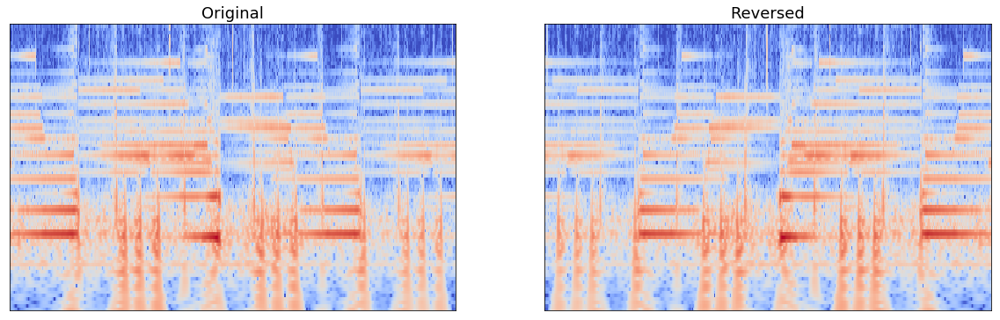

115/115398.mp3_cqt.npy    start second is 0.98    confidence is 0.9997

Original


Reverse


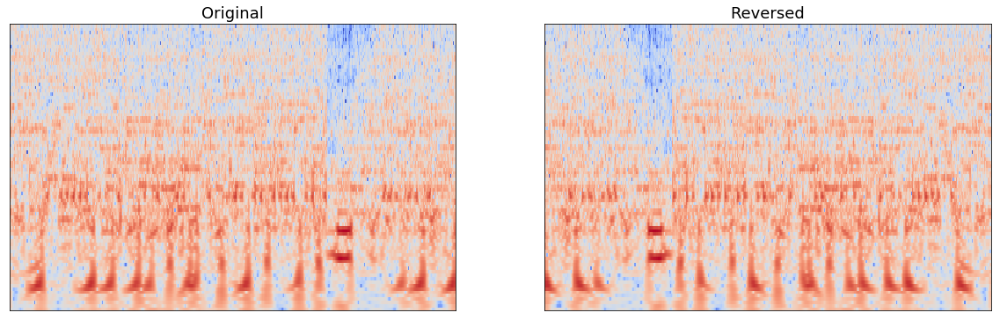

006/006174.mp3_cqt.npy    start second is 12.82    confidence is 0.9997

Original


Reverse


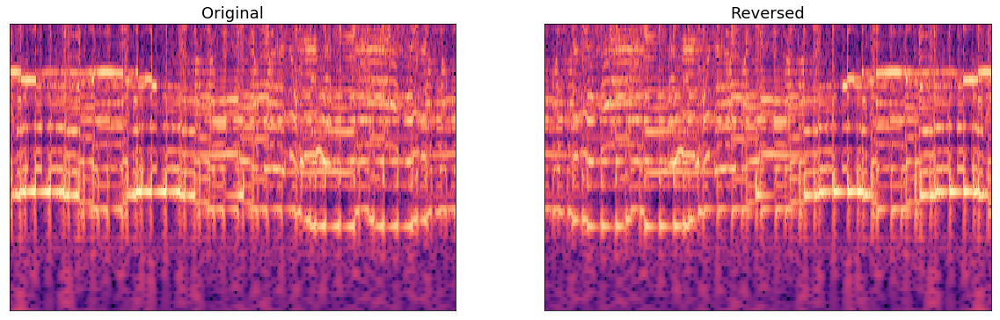

022/022173.mp3_cqt.npy    start second is 16.90    confidence is 0.9990

Original


Reverse


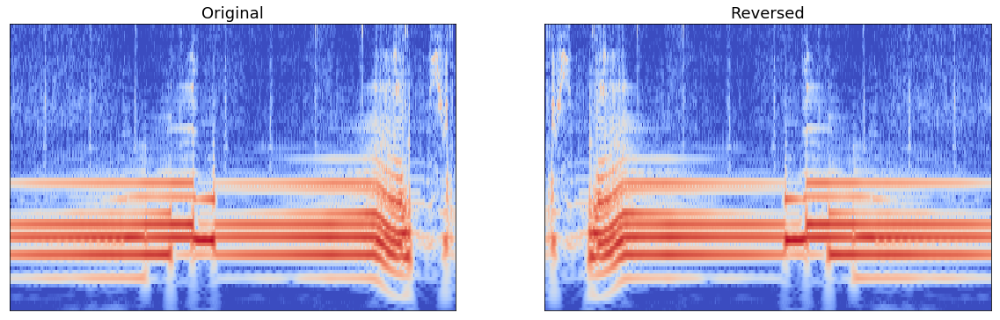

060/060324.mp3_cqt.npy    start second is 15.28    confidence is 0.9982

Original


Reverse


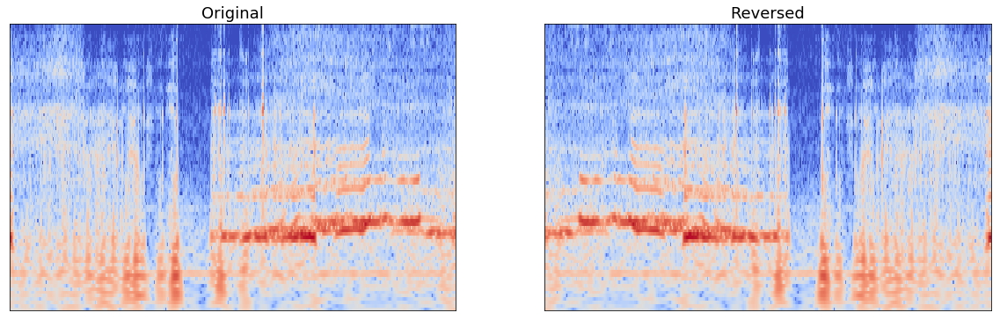

085/085498.mp3_cqt.npy    start second is 6.23    confidence is 0.9980

Original


Reverse


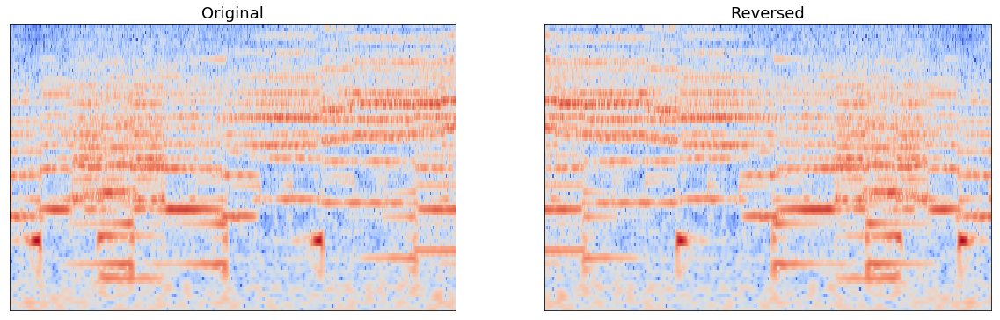

155/155021.mp3_cqt.npy    start second is 11.91    confidence is 0.9974

Original


Reverse


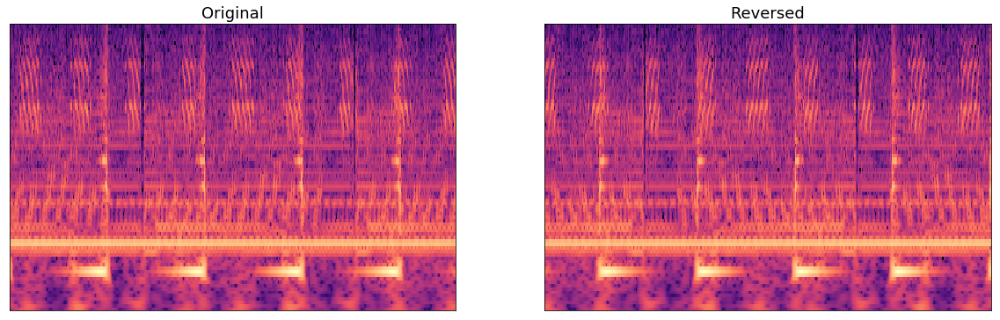

127/127895.mp3_cqt.npy    start second is 7.34    confidence is 0.9971

Original


Reverse


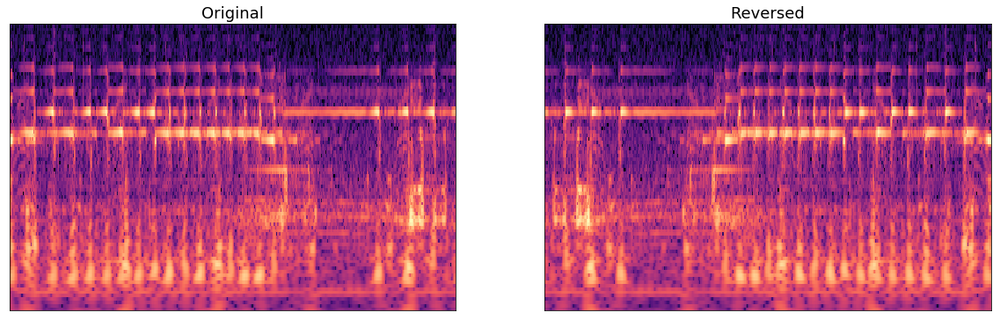

043/043061.mp3_cqt.npy    start second is 1.29    confidence is 0.9934

Original


Reverse


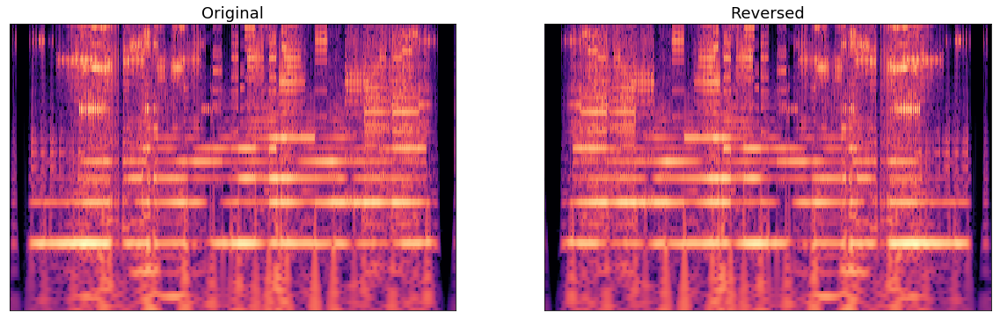

134/134635.mp3_cqt.npy    start second is 16.50    confidence is 0.9863

Original


Reverse


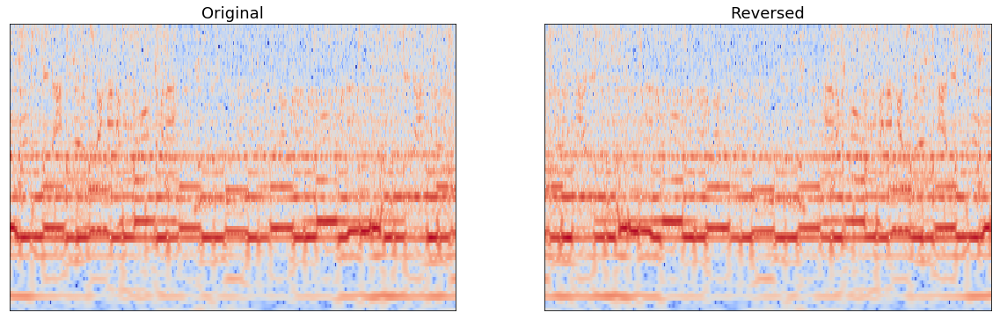

In [14]:
print('For all the below examples true label is not reversed while the model predicts them as reversed with high confidence\n')
num_examples_to_show = 10
for i in range(num_examples_to_show):
    print(f"{incorr_rev_with_hc['file_name'].iloc[i]}\
    start second is {incorr_rev_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {incorr_rev_with_hc['class_1_prob'].iloc[i]:.4f}")
          
    start_width = incorr_rev_with_hc['start_width'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + incorr_rev_with_hc['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    waveform_flip = np.flip(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)])
    waveform_flip = np.ascontiguousarray(waveform_flip, dtype=np.float32)
    rev_obj = ipd.Audio(waveform_flip, rate=SR)
    print('Reverse')
    ipd.display(rev_obj)
    soundnet.visualize_cqts(incorr_rev_with_hc['file_name'].iloc[i], 
                            start_width = start_width, display_reversed= True)
    plt.show()

#### Incorrectly not reverse classified with high confidence

For all the below examples true label is reversed while the model predicts them as not reversed with high confidence

138/138756.mp3_cqt.npy    start second is 0.42    confidence is 0.9997

Original


Reverse


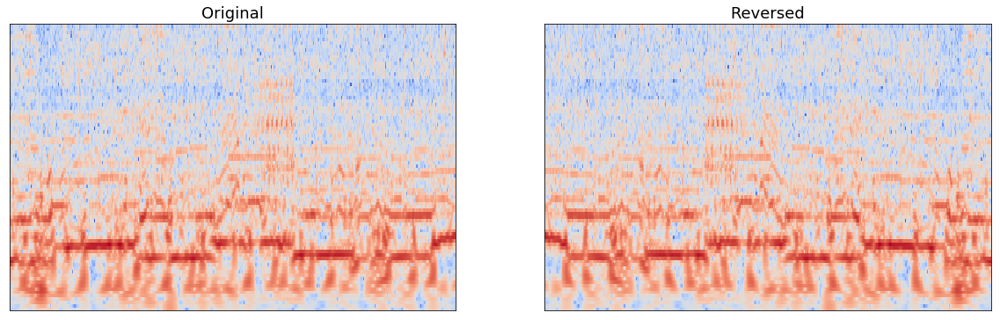

116/116163.mp3_cqt.npy    start second is 1.10    confidence is 0.9992

Original


Reverse


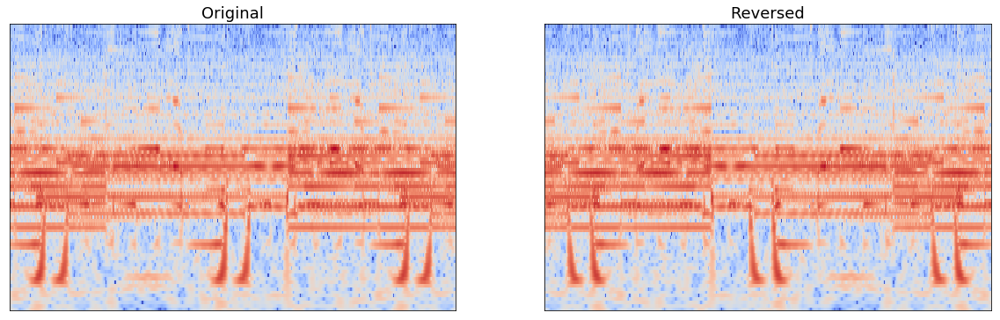

106/106524.mp3_cqt.npy    start second is 15.00    confidence is 0.9992

Original


Reverse


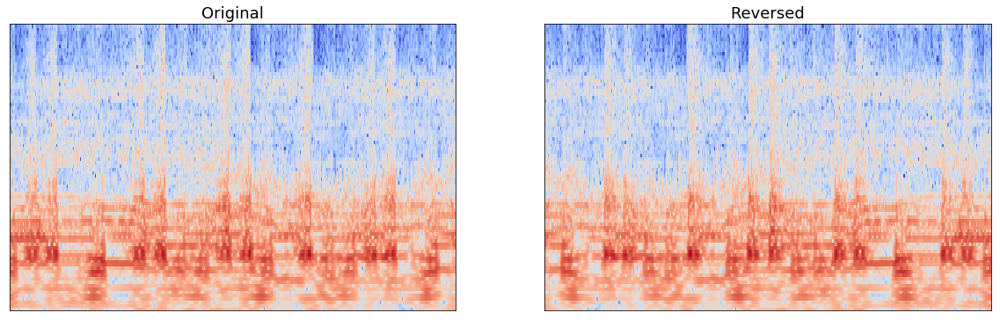

074/074017.mp3_cqt.npy    start second is 1.17    confidence is 0.9991

Original


Reverse


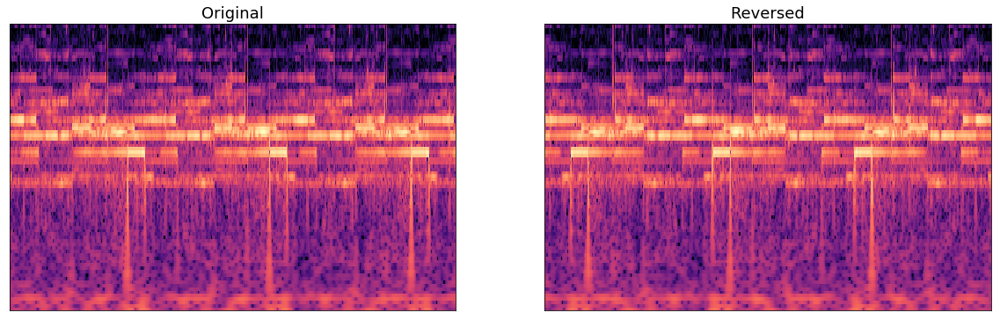

140/140034.mp3_cqt.npy    start second is 2.98    confidence is 0.9991

Original


Reverse


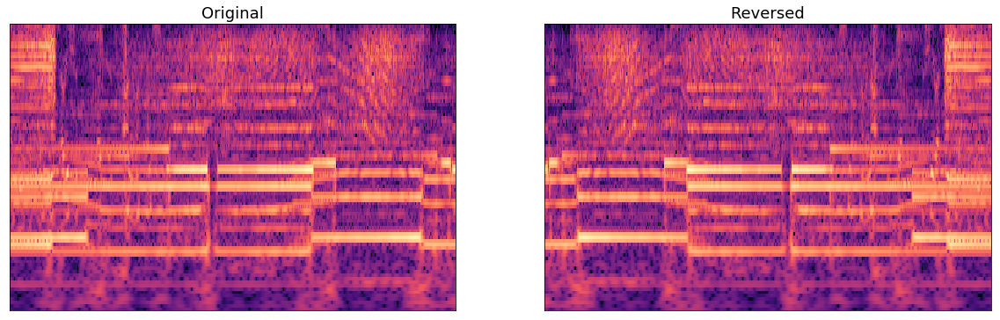

046/046064.mp3_cqt.npy    start second is 2.09    confidence is 0.9991

Original


Reverse


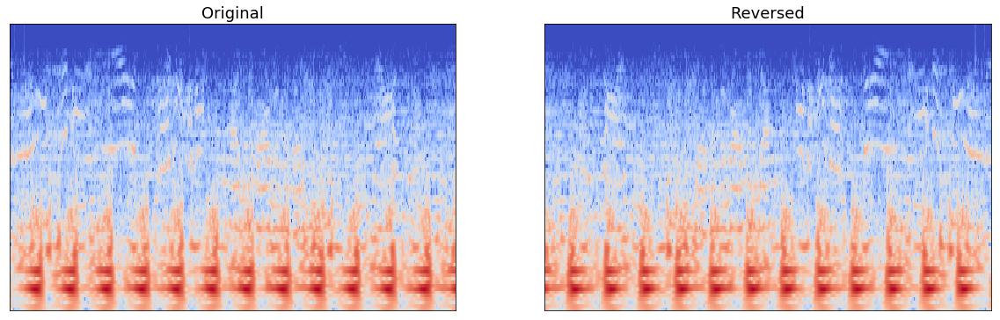

142/142193.mp3_cqt.npy    start second is 15.07    confidence is 0.9988

Original


Reverse


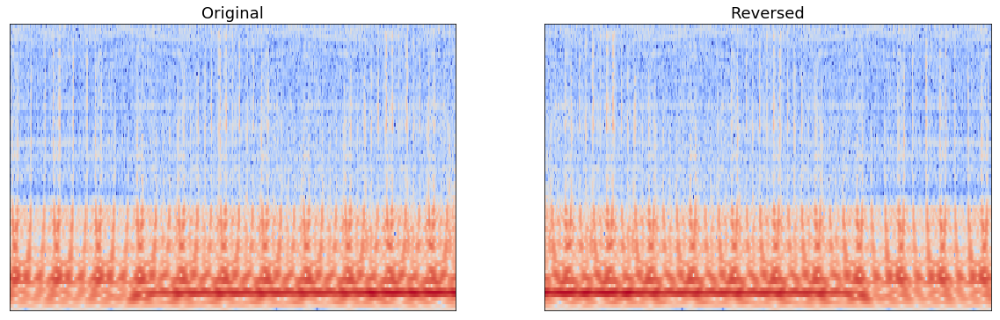

142/142287.mp3_cqt.npy    start second is 16.12    confidence is 0.9978

Original


Reverse


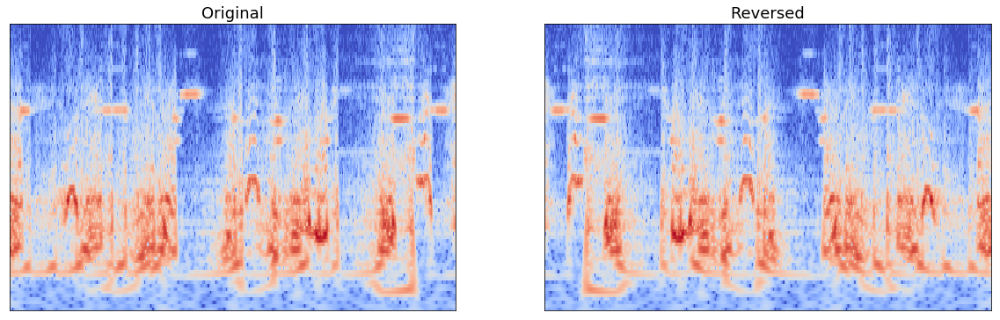

064/064128.mp3_cqt.npy    start second is 18.05    confidence is 0.9948

Original


Reverse


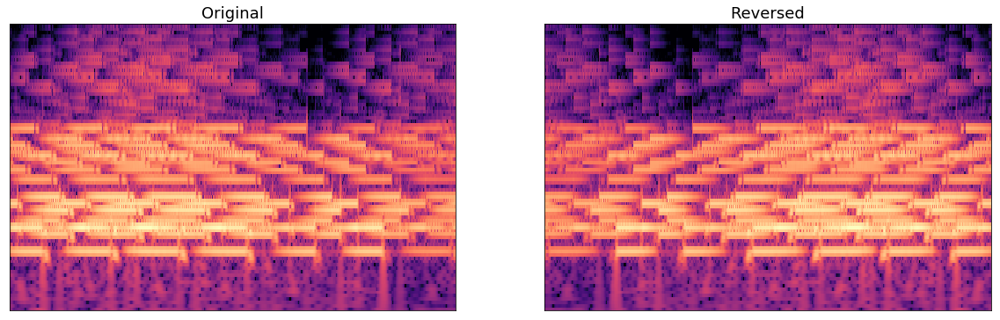

097/097279.mp3_cqt.npy    start second is 10.43    confidence is 0.9947

Original


Reverse


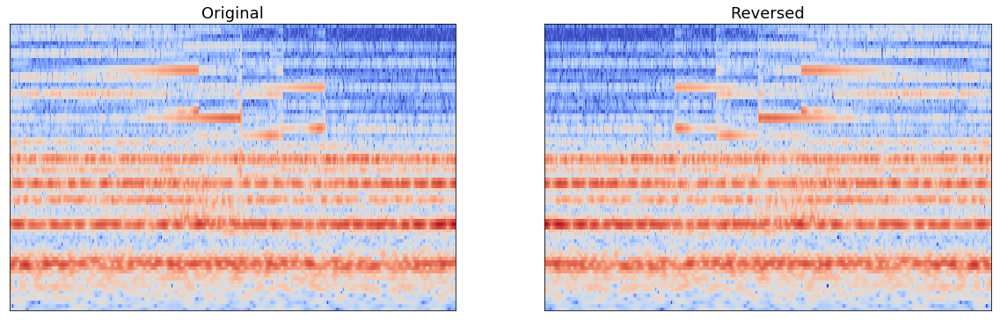

In [17]:
print('For all the below examples true label is reversed while the model predicts them as not reversed with high confidence\n')
num_examples_to_show = 10
for i in range(num_examples_to_show):
    print(f"{incorr_not_rev_with_hc['file_name'].iloc[i]}\
    start second is {incorr_not_rev_with_hc['start_width'].iloc[i]/1280 * 30:.2f}\
    confidence is {1-incorr_not_rev_with_hc['class_1_prob'].iloc[i]:.4f}")
          
    start_width = incorr_not_rev_with_hc['start_width'].iloc[i]
    waveform, _ = librosa.load(PATH_TO_AUDIO_FILES + incorr_not_rev_with_hc['file_name'].iloc[i][:-8], sr = SR)
    obj = ipd.Audio(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)], rate=SR)
    print()
    print('Original')
    ipd.display(obj)
    waveform_flip = np.flip(waveform[int(start_width*30/1280*SR):int((NUM_SECONDS + start_width*30/1280)*SR)])
    waveform_flip = np.ascontiguousarray(waveform_flip, dtype=np.float32)
    rev_obj = ipd.Audio(waveform_flip, rate=SR)
    print('Reverse')
    ipd.display(rev_obj)
    soundnet.visualize_cqts(incorr_not_rev_with_hc['file_name'].iloc[i], 
                            start_width = start_width, display_reversed= True)
    plt.show()